# W09: Exploring Style Space by Replacing Data Points with Pictures

In [2]:
# For data
import pandas as pd
import numpy as np

# For images
from matplotlib.image import PIL # The Python Image Libary is used by Matplotlib
import colorsys # This built in library will allow use to extract hue, color, and brightness

# For plotting
import matplotlib.pyplot as plt
import matplotlib.image as mpimg # These are image processing functions in Matplotlib
from matplotlib.offsetbox import OffsetImage, AnnotationBbox # This will all us to put images on our plots
import seaborn as sns

# For easy file access
import glob

In [3]:
sns.set_theme(context="notebook", style="dark")

# Example

In [4]:
artist = 'balla'
# artist = 'okeeffe'

In [5]:
image_files = glob.glob(f"{artist}/*.jpg")

## Look at a single image

In [6]:
img_file = image_files[13]
img_file

'balla/22_Balla-Lignes-ForcesduPaysages_-1917-18.jpg'

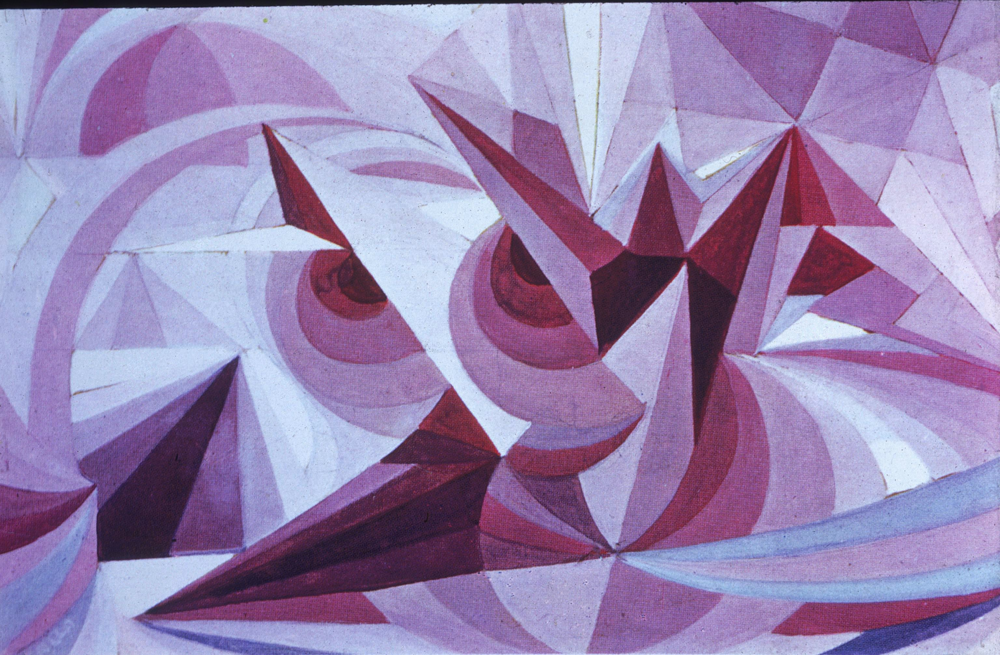

In [7]:
img = PIL.Image.open(img_file)
img

In [8]:
img.thumbnail((256, 256))

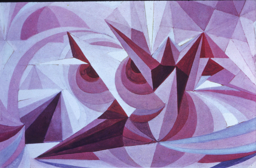

In [9]:
img

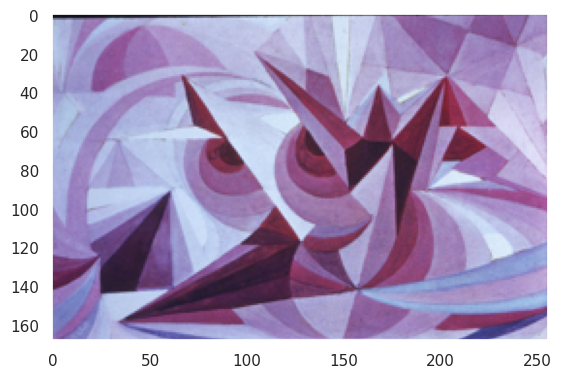

In [10]:
plt.imshow(img)
plt.show()

In [11]:
img_data = img.getdata()

In [12]:
list(img_data)[:10]

[(15, 16, 21),
 (16, 17, 22),
 (16, 17, 22),
 (16, 17, 22),
 (17, 17, 22),
 (17, 17, 23),
 (18, 17, 24),
 (18, 17, 24),
 (18, 17, 24),
 (17, 17, 23)]

Get the mean of the RGB values.

In [13]:
pd.DataFrame(list(img_data)).mean()

0    151.915992
1    132.334728
2    176.272182
dtype: float64

Define a function to extract mean R, G, and B values from an image.

In [14]:
def extract_mean_colors(my_img):
    h = my_img.entropy()
    my_rgb = pd.DataFrame(list(my_img.getdata()), columns=['r','g','b']).mean().round()
    my_rgb['entropy'] = h
    return my_rgb

In [15]:
extract_mean_colors(img)

r          152.000000
g          132.000000
b          176.000000
entropy      8.950047
dtype: float64

Define a function to extract mean H, S, and V values from an image.

In [16]:
def extract_mean_hsv(my_img):
    pixels = my_img.getdata()
    hsv = [colorsys.rgb_to_hsv(*(np.array(pxl)/255.)) for pxl in pixels]
    my_hsv = pd.DataFrame(hsv, columns=['h','s','v']).mean()
    return my_hsv

In [17]:
def extract_std_hsv(my_img):
    pixels = my_img.getdata()
    hsv = [colorsys.rgb_to_hsv(*(np.array(pxl)/255.)) for pxl in pixels]
    my_hsv = pd.DataFrame(hsv, columns=['h_std','s_std','v_std']).std()
    return my_hsv

In [18]:
extract_mean_hsv(img)

h    0.735584
s    0.313197
v    0.707586
dtype: float64

In [19]:
extract_std_hsv(img)

h_std    0.095339
s_std    0.129201
v_std    0.198022
dtype: float64

## Put all of the images in a data frame

Put images file names in a data frame.

In [20]:
# Create a data frame of images from the file names
IMAGES = pd.DataFrame({"file_name":image_files})

# Creates images from files (so we don't have to keep creating them)
IMAGES['img'] = IMAGES.file_name.apply(PIL.Image.open)

# Reduce size for efficiency
IMAGES.img.apply(lambda x: x.thumbnail((256,256)))

# Extract artist names from file names
IMAGES['artist'] = IMAGES.file_name.str.split("/").str[2]

# Extract years from file names
IMAGES['year'] = IMAGES.file_name.str.extract(r"(\d{4})") #.astype(int)
IMAGES = IMAGES.dropna(subset=['year'])
IMAGES.year = IMAGES.year.astype(int)

Extract mean HSV and RGB for all images.

In [21]:
IMAGES[['h', 's', 'v']] = IMAGES.img.apply(extract_mean_hsv)
IMAGES[['h_std', 's_std', 'v_std']] = IMAGES.img.apply(extract_std_hsv)
IMAGES['hsv_sum'] = IMAGES[['h','s','v']].sum(1)
IMAGES[['r', 'g', 'b', 'entropy']] = IMAGES.img.apply(extract_mean_colors)

Get a few more features for visualization.

In [22]:
IMAGES['rgb_sum'] = IMAGES[['r', 'g', 'b']].sum(1)
IMAGES['rgb_norm'] = IMAGES.apply(lambda x: [x.r/255., x.g/255., x.b/255.], axis=1)

Make sure all images of year data.

In [23]:
int(IMAGES.year.isna().sum() / len(IMAGES) * 100)

0

In [24]:
IMAGES.head()

,file_name,img,artist,year,h,s,v,h_std,s_std,v_std,hsv_sum,r,g,b,entropy,rgb_sum,rgb_norm
0,balla/10_Balla-GirlRunning...-1912.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN,1912,0.260266,0.034980,0.488253,0.318182,0.024148,0.241385,0.783499,124.0,123.0,122.0,9.222002,369.0,"[0.48627450980392156, 0.4823529411764706, 0.47..."
1,balla/11_Balla-FlightSwifts-1913.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN,1913,0.663150,0.127974,0.591222,0.019866,0.107799,0.227989,1.382346,137.0,138.0,151.0,8.071531,426.0,"[0.5372549019607843, 0.5411764705882353, 0.592..."
2,balla/12_Balla-PortraitOpenAir-1902-3.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN,1902,0.372906,0.149234,0.528594,0.362363,0.081709,0.189484,1.050733,132.0,122.0,120.0,8.950919,374.0,"[0.5176470588235295, 0.47843137254901963, 0.47..."
3,balla/13_Balla-Self-Portrait-1902.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN,1902,0.294947,0.266603,0.605979,0.362394,0.149587,0.190803,1.167529,151.0,126.0,122.0,9.153470,399.0,"[0.592156862745098, 0.49411764705882355, 0.478..."
4,balla/14_Balla-MutilatedTrees(Lumbering)-1918.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=...,NaN,1918,0.282745,0.266539,0.409864,0.371958,0.134787,0.146178,0.959148,104.0,86.0,79.0,8.480008,269.0,"[0.40784313725490196, 0.33725490196078434, 0.3..."


Show all the images.

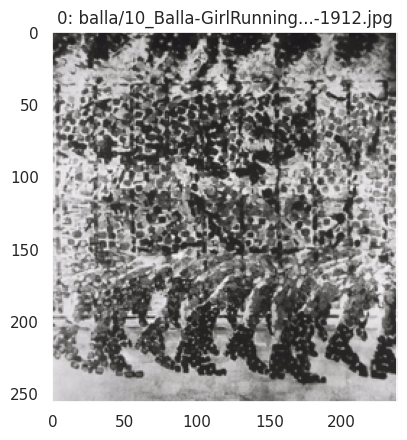

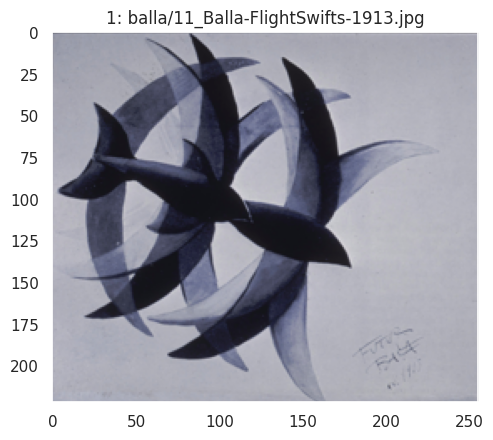

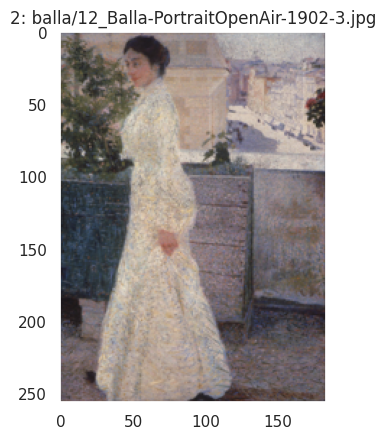

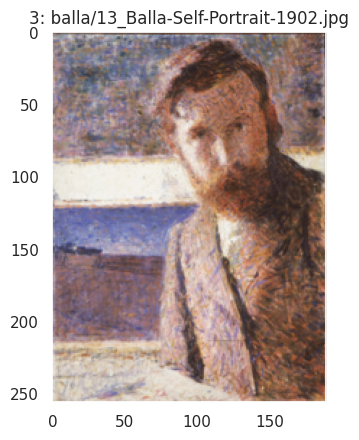

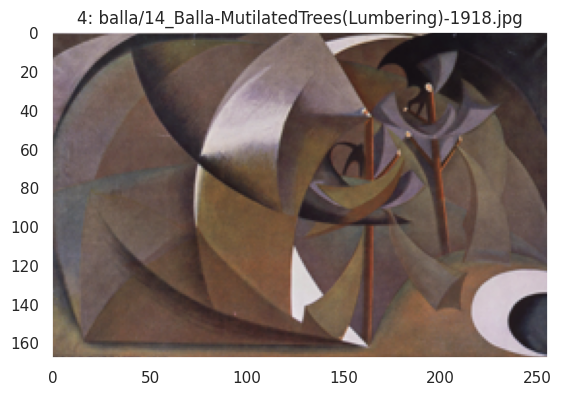

...

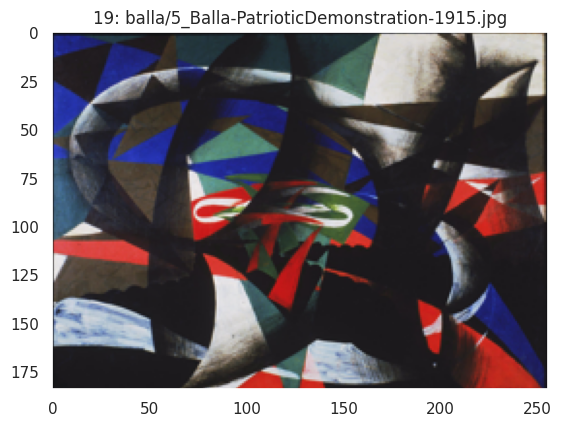

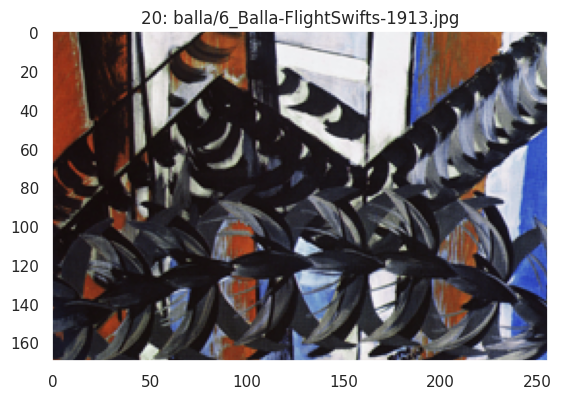

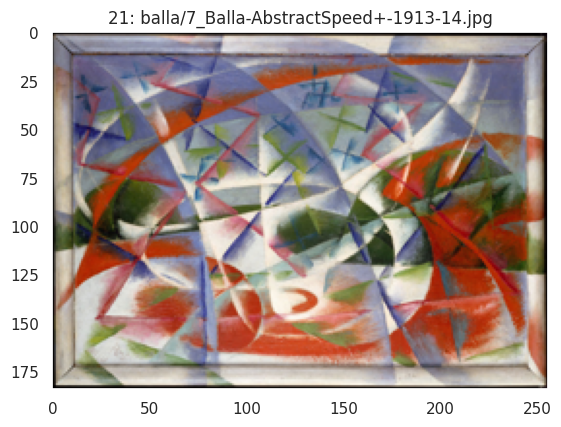

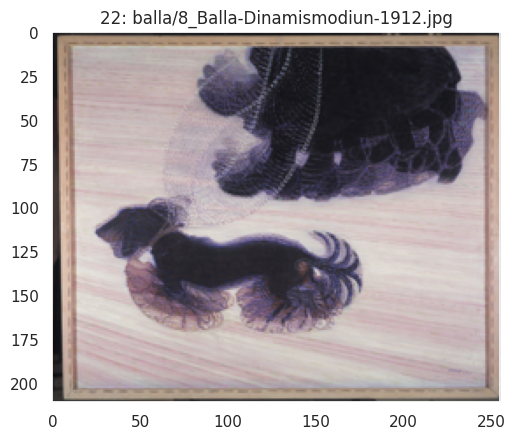

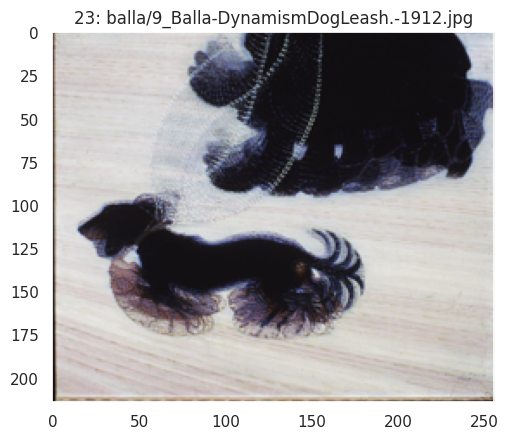

In [25]:
for idx, row in IMAGES.iterrows():
    plt.imshow(row.img)
    plt.title(str(idx) + ": " + row.file_name)
    plt.show()

Try out some visualizations.

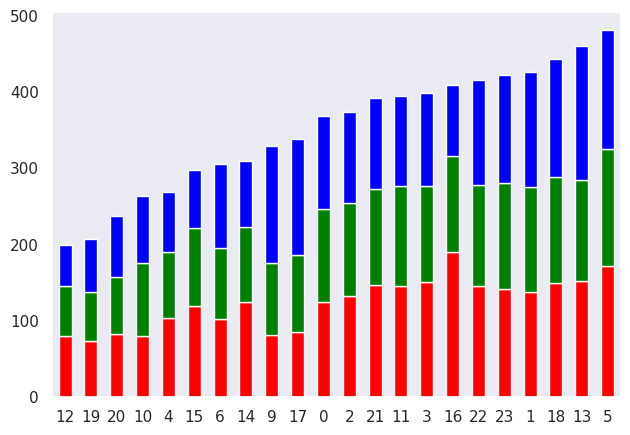

In [26]:
rgb_sorted_index = IMAGES.rgb_sum.sort_values().index
IMAGES.loc[rgb_sorted_index, ['r','g','b']]\
        .plot.bar(stacked=True, rot=0, color=['red', 'green', 'blue'], legend=False, figsize=(len(IMAGES)/3, 5))
plt.show()

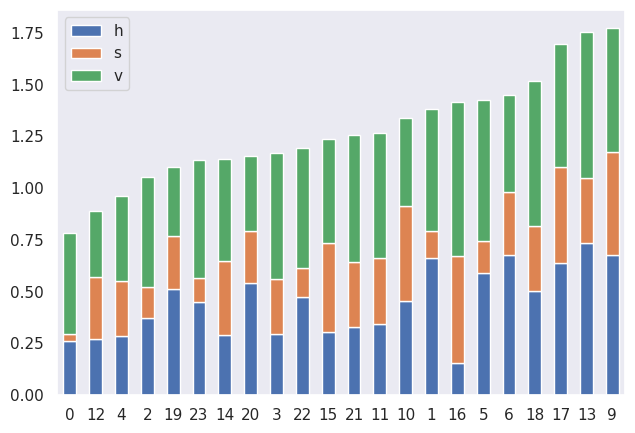

In [27]:
hsv_sorted_index = IMAGES.hsv_sum.sort_values().index
IMAGES.loc[hsv_sorted_index, ['h','s','v']]\
    .plot.bar(stacked=True, rot=0, legend=True, figsize=(len(IMAGES)/3, 5))
plt.show()

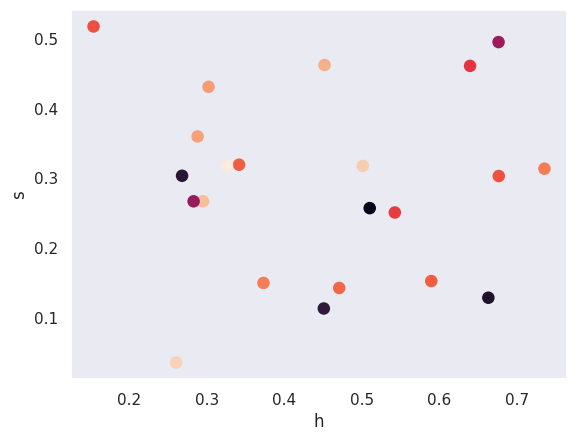

In [28]:
IMAGES.plot.scatter(x='h', y='s', c=IMAGES.entropy, s=64)
plt.show()

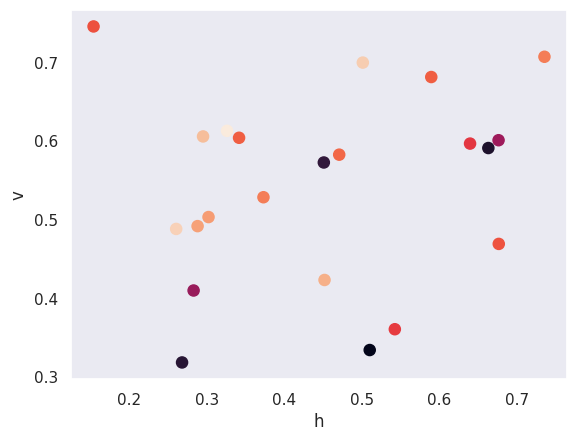

In [29]:
IMAGES.plot.scatter(x='h', y='v', c=IMAGES.entropy, s=64)
plt.show()

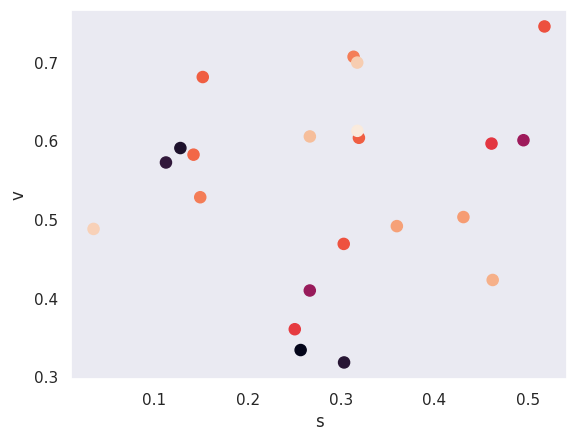

In [30]:
IMAGES.plot.scatter(x='s', y='v', c=IMAGES.entropy, s=64)
plt.show()

Now, visualize scatter plots with pictures as data points.

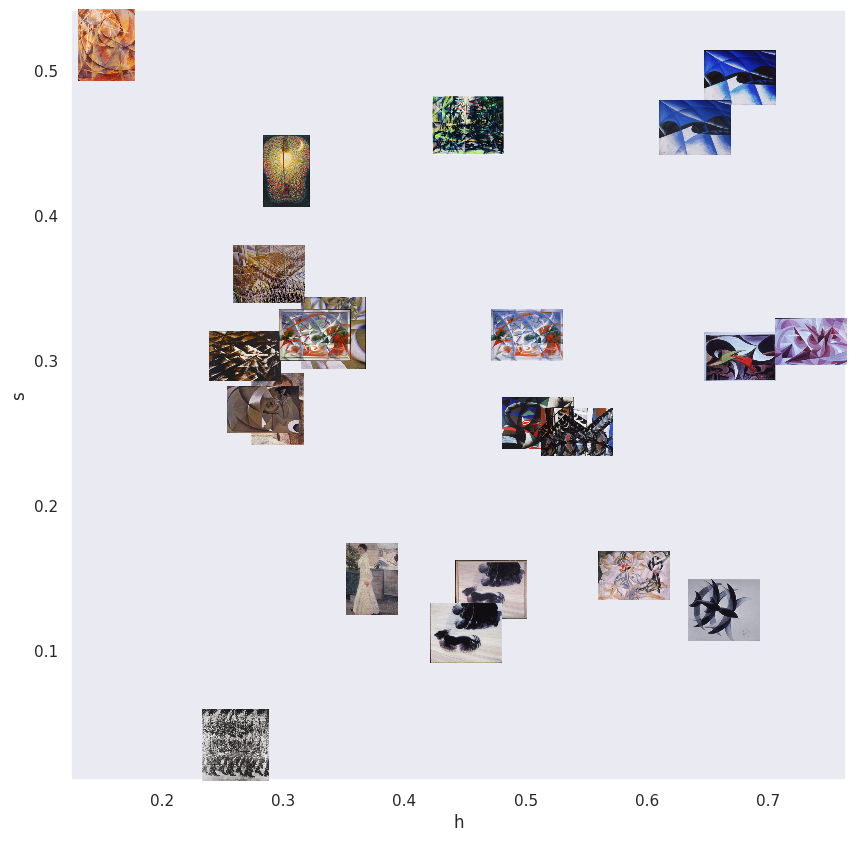

In [31]:
# Choose two color features
c1 = 'h'
c2 = 's'

# Create a new figure and axes
fig, ax = plt.subplots(figsize=(10, 10))

# Put a scatter plot on the axes
# Use invisible points (alpha = 0) since we are going to use images 
ax.scatter(IMAGES[c1], IMAGES[c2], alpha=0)  

# Note, we could have used Pandas to create our axes object
# ax = IMAGES.plot.scatter(x=c1, y=c2, figsize=(20, 20), alpha=0)

# Iterate through the data to assign images to each point
for idx, row in IMAGES.iterrows():

    # Create an image using PIL
    my_img = row.img
    
    # Convert to array and normalize the values
    my_img_array = np.array(my_img) / 255.0  
    
    # Create an image box and adjust zoom as needed
    # This wraps the image data and prepares it for matplotlib's artist system
    # This also specifies the size of the image to plot
    imagebox = OffsetImage(my_img_array, zoom=.2) 
    
    # Put the image in an "AnnotationBbox"
    # This specifies *where* to put the image on the plot
    x = row[c1]
    y = row[c2]
    ab = AnnotationBbox(imagebox, (x, y), frameon=False, pad=0)
    
    # Add the annotationbbox to the plot
    # An artist is any object that gets drawn on a figure
    ax.add_artist(ab)

plt.xlabel(c1)
plt.ylabel(c2)
plt.savefig('my_plot.svg', format='svg')
plt.show()

In [32]:
def imageplot(X, c1='r', c2='g', figsize=(10,10), zoom=.2, rot=0):
    
    fig, ax = plt.subplots(figsize=figsize)
    ax.scatter(X[c1], X[c2], alpha=0)  # Invisible points, just for axes
    
    for idx, row in X.iterrows():
        my_img = row.img
        my_img_array = np.array(my_img) / 255.0  # Convert to array and normalize
        imagebox = OffsetImage(my_img_array, zoom=zoom) # Adjust zoom as needed
        x = row[c1]
        y = row[c2]
        ab = AnnotationBbox(imagebox, (x, y), frameon=False, pad=0)
        ax.add_artist(ab)
    
    plt.xticks(rotation=rot)
    plt.xlabel(c1)
    plt.ylabel(c2)
    plt.show()

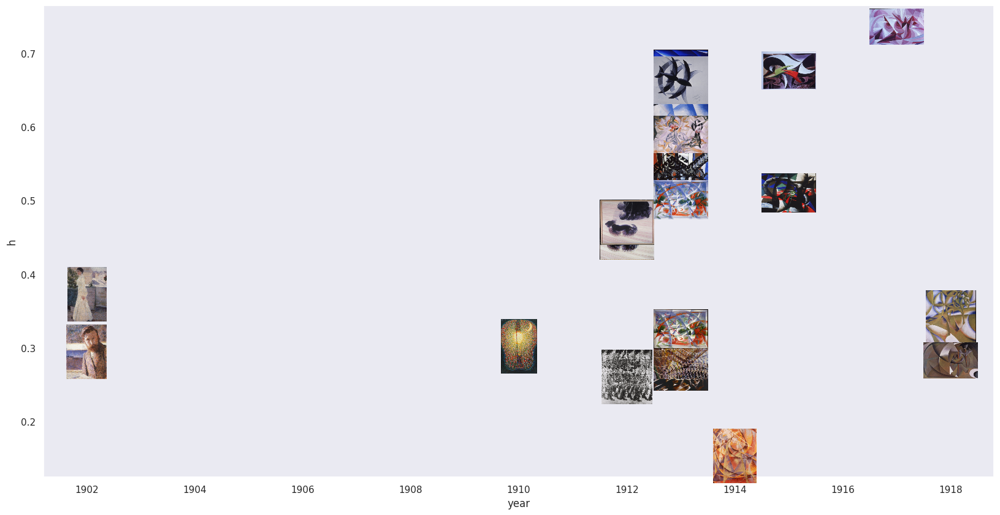

In [33]:
imageplot(IMAGES.sort_values('year'), 'year', 'h', figsize=(20,10), zoom=.25)

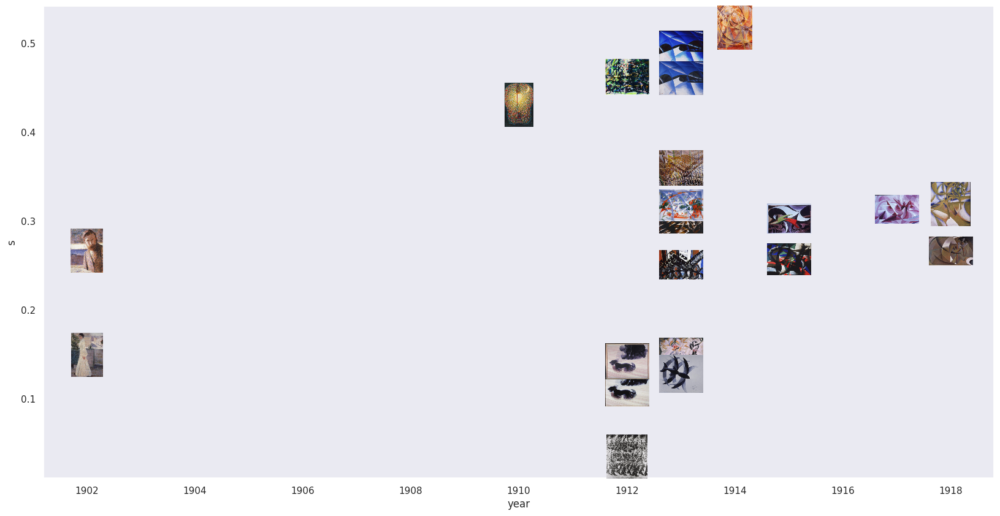

In [34]:
imageplot(IMAGES.sort_values('year'), 'year', 's', figsize=(20,10))

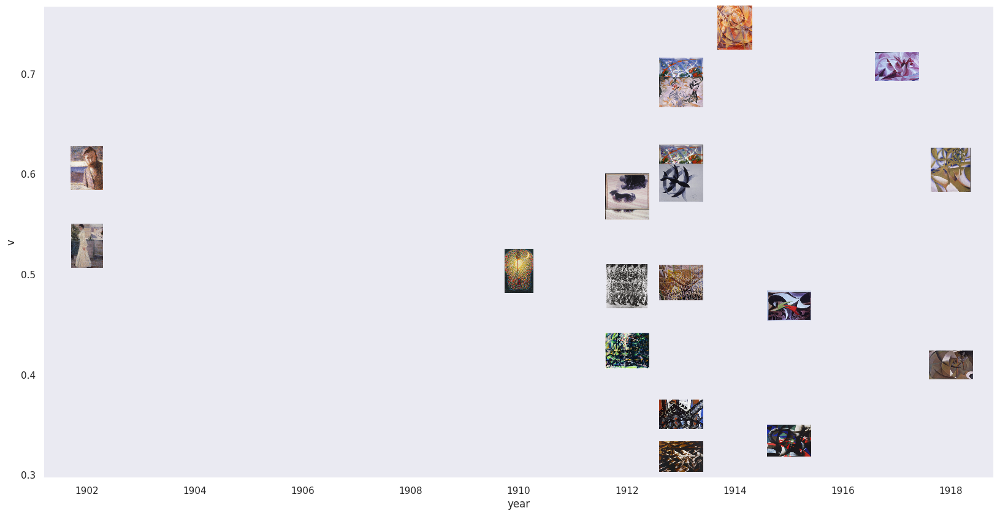

In [35]:
imageplot(IMAGES.sort_values('year'), 'year', 'v', figsize=(20, 10))

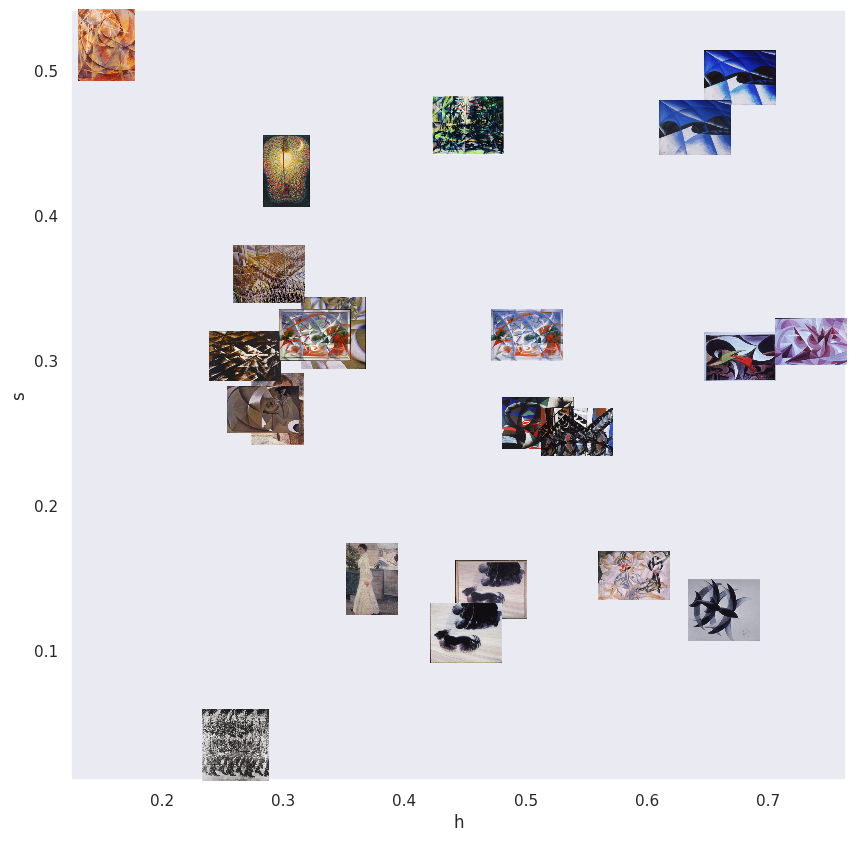

In [36]:
imageplot(IMAGES, 'h', 's')

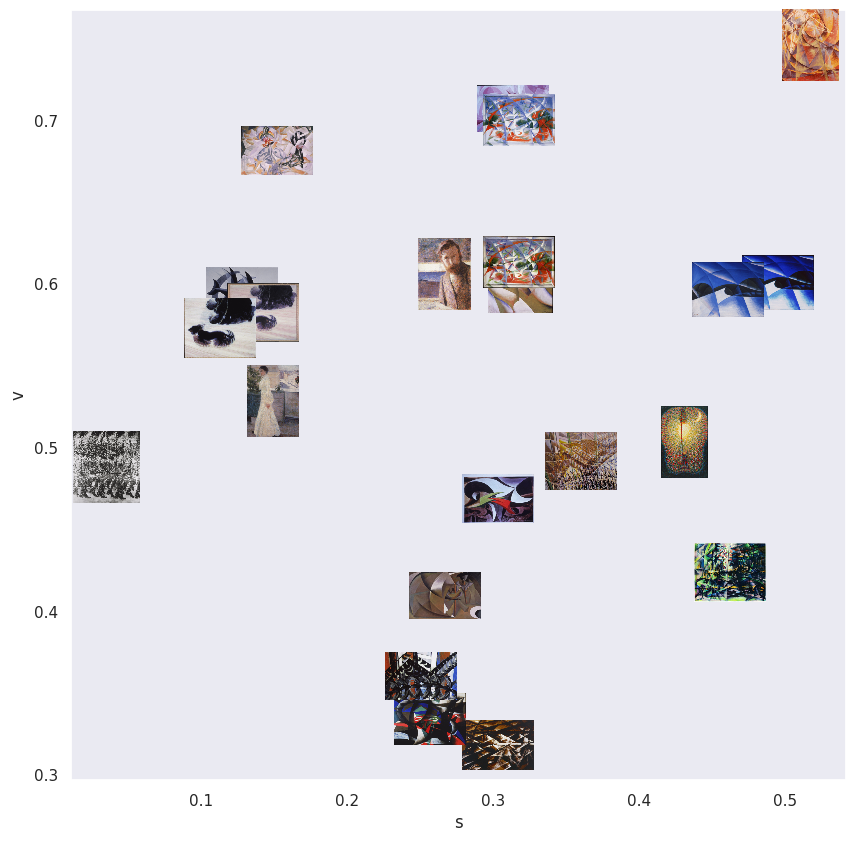

In [37]:
imageplot(IMAGES, 's', 'v')

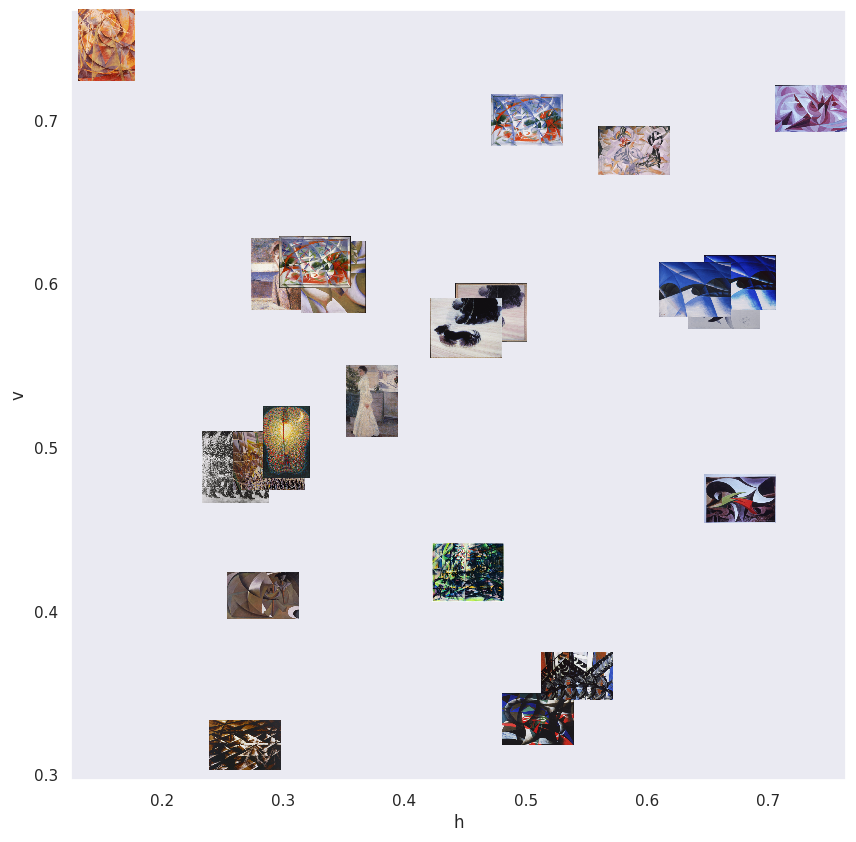

In [38]:
imageplot(IMAGES, 'h', 'v')

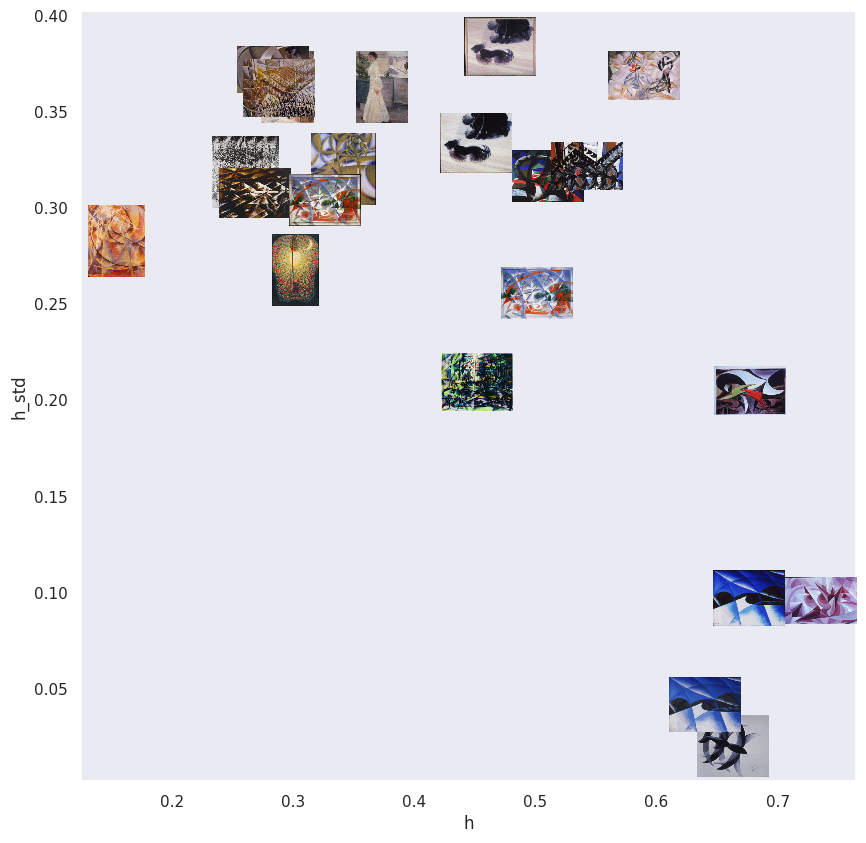

In [39]:
imageplot(IMAGES, 'h', 'h_std')

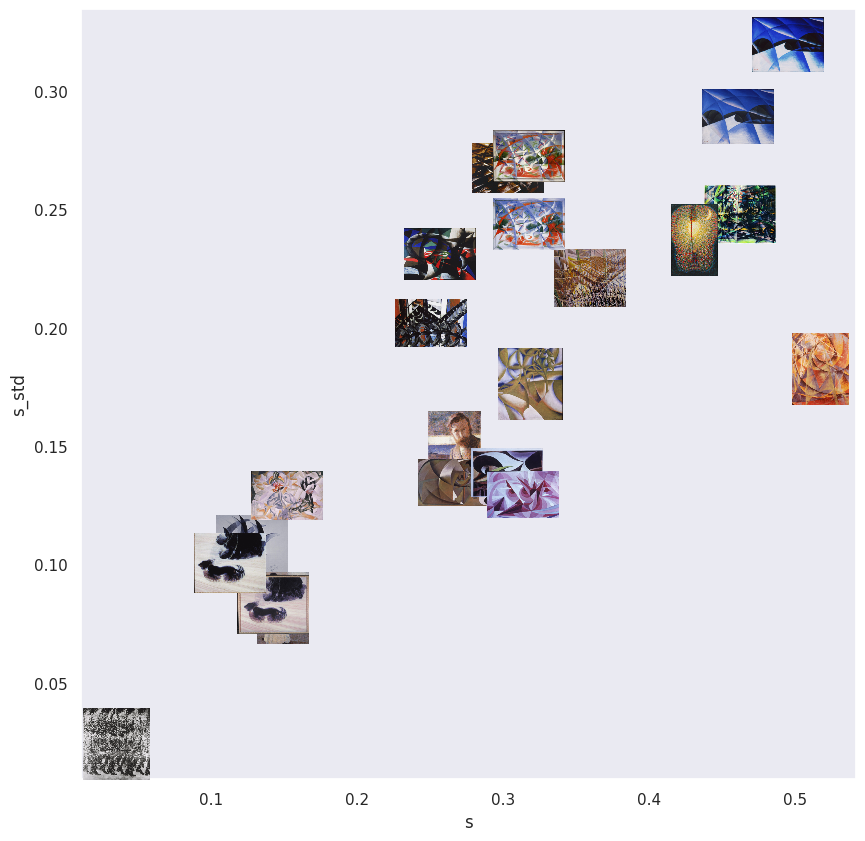

In [40]:
imageplot(IMAGES, 's', 's_std')

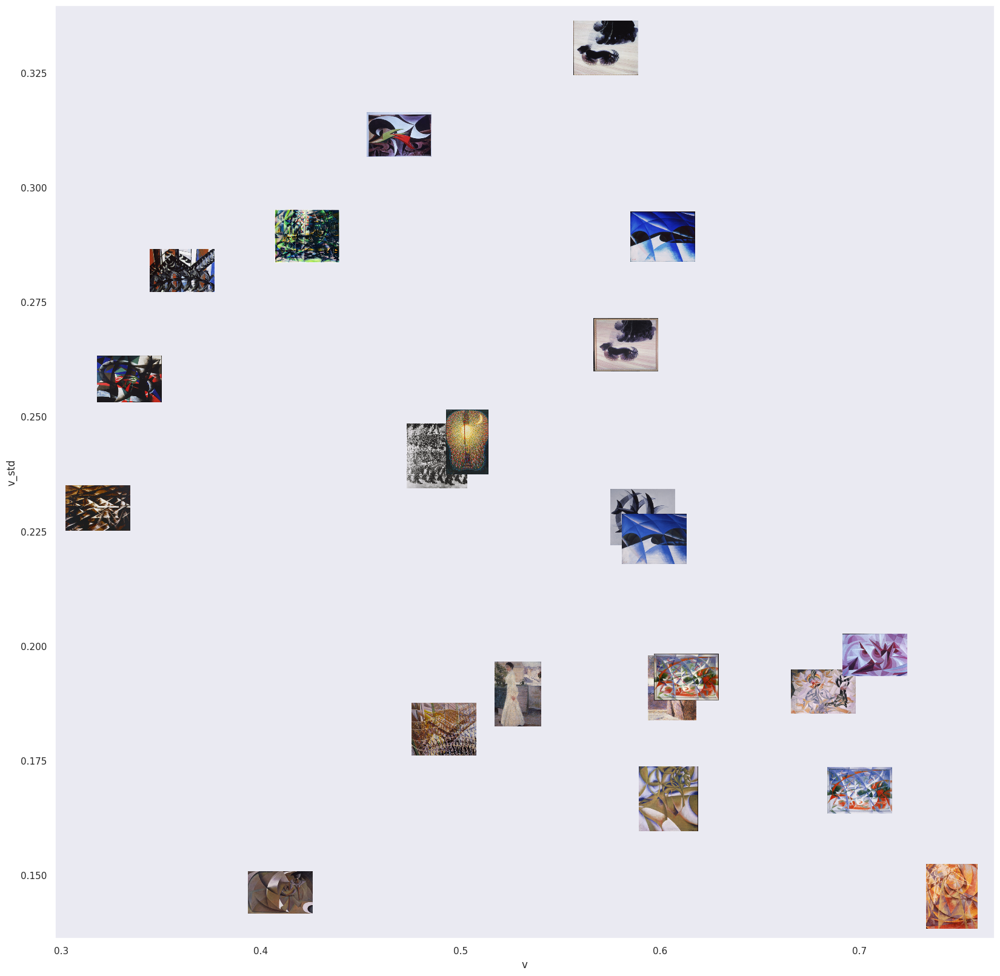

In [41]:
imageplot(IMAGES, 'v', 'v_std', figsize=(20,20), zoom=.3)